In [ ]:
#Code imported from https://github.com/ankitvgupta/densenet_1d
%pip install talos
!git clone https://github.com/ankitvgupta/densenet_1d.git
!pip install git+https://github.com/ankitvgupta/densenet_1d.git

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.4/56.4 KB 2.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.3/52.3 KB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 33.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.4/26.4 MB 48.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 61.5 MB/s eta 0:00:00
  Created wheel for chances: filename=chances-0.1.9-py3-none-any.whl size=41606 sha256=29801c4470915c4ad211481c9bf3ed9ef163509707d7f82f79a0bbc570505975
  Stored in directory: /root/.cache/pip/wheels/c3/26/2b/8ae098b8e9dd7cc1fd0a9131c0f1efea60d710ff7906bf0ab4
  Created wheel for sklearn: filename=sklearn-0.0.post1-py3-none-any.whl size=2955 sha256=4712f43c748816af3a4f9eac9ba066e5074cd3352ba9e46fda21dfc490395caf
  Stor

In [ ]:
#sklearn
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn import metrics
from sklearn.metrics import confusion_matrix, accuracy_score, roc_curve, auc, roc_auc_score, f1_score


#Other
from google.colab import drive
import pandas as pd
import numpy as np
import csv
import time
from scipy import interp
from itertools import cycle
import seaborn as snNew
import matplotlib.pyplot as plt

#Keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Embedding, MaxPooling1D
from keras.layers import Conv1D, GlobalMaxPooling1D, GlobalAveragePooling1D, BatchNormalization
from keras.preprocessing.text import Tokenizer
from keras.preprocessing import sequence
from keras import metrics
from keras.callbacks import EarlyStopping
from tensorflow.keras import layers
from tensorflow.keras.applications import DenseNet121
import keras
from densenet.classifiers.one_d import DenseNet121

#Imblearn
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler
import imblearn
from imblearn.over_sampling import SMOTE

In [ ]:
#Importing Data
drive.mount('/content/drive')
df = pd.read_csv('/content/drive/MyDrive/Thesis/Raw_data_thesis.csv', index_col = 0)

Mounted at /content/drive


In [ ]:
#Feature transformation
#Create X and Y
X = df.drop('target_y', axis = 1)
y = df['target_y']

#Label-encode y
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
y_enc = le.fit_transform(y)
#One-hot encoding
y_list = []
for item in y_enc:
  zer = np.zeros(6)
  zer[item] = 1
  y_list.append(zer)

y = np.array(y_list)

In [ ]:
#Initial Split Dataset
X_train, X_inter, y_train, y_inter = train_test_split(X, y, train_size = 0.8, random_state=42, stratify = y)
#Further dividing testing data into validation and testing
X_val, X_test, y_val, y_test = train_test_split(X_inter, y_inter, train_size = 0.5, random_state=42, stratify = y_inter)
#Dividing training set for data augmentation
X_train_aug, X_val_aug, y_train_aug, y_val_aug = train_test_split(X_train, y_train, train_size = 0.7, random_state=42, stratify = y_train)

In [ ]:
#Implementing Oversampling with SMOTE
#Implement SMOTE
oversample = SMOTE()
X_SMOTE, y_SMOTE = oversample.fit_resample(X_train_aug, y_train_aug)
#Random Undersampling
undersample = RandomUnderSampler(sampling_strategy='majority')
X_under, y_under = undersample.fit_resample(X_train_aug, y_train_aug)
#Random Oversampling
oversample = RandomOverSampler(sampling_strategy='minority')
X_rand_over, y_rand_over = oversample.fit_resample(X_train_aug, y_train_aug)

In [ ]:
#Defining summarizing structure for loss and accuracy curves
def summarize_diagnostics(history):
	# plot loss
  plt.subplot(211)
  plt.title('Cross Entropy Loss')
  plt.plot(history.history['loss'], color='blue', label='train')
  plt.plot(history.history['val_loss'], color='orange', label='test')
	# plot accuracy
  plt.subplot(212)
  plt.title('Classification Accuracy')
  plt.plot(history.history['accuracy'], color='blue', label='train')
  plt.plot(history.history['val_accuracy'], color='orange', label='test')
  plt.legend(['training', 'validation'])
  plt.show()

Epoch 1/50
92/92 [==============================] - 2s 7ms/step - loss: 1.6288 - accuracy: 0.3007 - val_loss: 1.1628 - val_accuracy: 0.6046
Epoch 2/50
92/92 [==============================] - 0s 5ms/step - loss: 1.0150 - accuracy: 0.6171 - val_loss: 0.6154 - val_accuracy: 0.8419
Epoch 3/50
92/92 [==============================] - 0s 5ms/step - loss: 0.7062 - accuracy: 0.7531 - val_loss: 0.4407 - val_accuracy: 0.8658
Epoch 4/50
92/92 [==============================] - 0s 5ms/step - loss: 0.6022 - accuracy: 0.7832 - val_loss: 0.3635 - val_accuracy: 0.8706
Epoch 5/50
92/92 [==============================] - 0s 5ms/step - loss: 0.5442 - accuracy: 0.8010 - val_loss: 0.3342 - val_accuracy: 0.8794
Epoch 6/50
92/92 [==============================] - 1s 5ms/step - loss: 0.5043 - accuracy: 0.8106 - val_loss: 0.3291 - val_accuracy: 0.8722
Epoch 7/50
92/92 [==============================] - 0s 5ms/step - loss: 0.4825 - accuracy: 0.8195 - val_loss: 0.3078 - val_accuracy: 0.8786
Epoch 8/50
92/92 [==

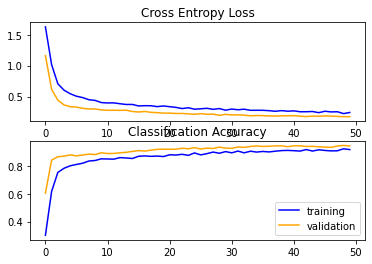

40/40 [==============================] - 0s 2ms/step
0.9505760681056561
0.9432907348242812


In [ ]:
#Implementing Model 1 for original dataset testing
#Model adapted from Ma et al. (2021). See https://doi.org/10.1016/j.saa.2021.119732
simple_model = Sequential()

#Add layers
simple_model.add(layers.Conv1D(5, 10, strides = 2, activation='LeakyReLU', input_shape = (1531,1)))
simple_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2))
simple_model.add(layers.Flatten())
simple_model.add(layers.Dense(12, activation='LeakyReLU'))
simple_model.add(layers.Dropout(0.5))
simple_model.add(layers.Dense(6, activation='softmax'))

simple_model.compile(optimizer='adam',
              loss='categorical_crossentropy',
               metrics=['accuracy'])

original_data = simple_model.fit(X_train_aug, y_train_aug, epochs=50, batch_size=32, validation_data=(X_val_aug, y_val_aug))
summarize_diagnostics(original_data)
y_pred = np.argmax(simple_model.predict(X_val_aug), axis = 1)
print(f1_score(np.argmax(y_val_aug, axis = 1), y_pred , average="macro"))
print(f1_score(np.argmax(y_val_aug, axis = 1), y_pred , average="micro"))

Epoch 1/50
105/105 [==============================] - 2s 7ms/step - loss: 1.2672 - accuracy: 0.4768 - val_loss: 0.8920 - val_accuracy: 0.7268
Epoch 2/50
105/105 [==============================] - 1s 5ms/step - loss: 0.8033 - accuracy: 0.7039 - val_loss: 0.6255 - val_accuracy: 0.8419
Epoch 3/50
105/105 [==============================] - 1s 5ms/step - loss: 0.6633 - accuracy: 0.7598 - val_loss: 0.4943 - val_accuracy: 0.8482
Epoch 4/50
105/105 [==============================] - 1s 5ms/step - loss: 0.5935 - accuracy: 0.7708 - val_loss: 0.4202 - val_accuracy: 0.8626
Epoch 5/50
105/105 [==============================] - 0s 5ms/step - loss: 0.5270 - accuracy: 0.8021 - val_loss: 0.4077 - val_accuracy: 0.8514
Epoch 6/50
105/105 [==============================] - 1s 5ms/step - loss: 0.4829 - accuracy: 0.8170 - val_loss: 0.3561 - val_accuracy: 0.8714
Epoch 7/50
105/105 [==============================] - 1s 5ms/step - loss: 0.4853 - accuracy: 0.8137 - val_loss: 0.3746 - val_accuracy: 0.8419
Epoch 

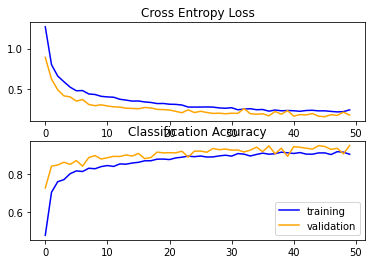

40/40 [==============================] - 0s 2ms/step
0.9576455870535298
0.9512779552715654


In [ ]:
#Implementing Model 1 for SMOTE testing
#Model adapted from Ma et al. (2021). See https://doi.org/10.1016/j.saa.2021.119732
simple_model = Sequential()

#Add layers
simple_model.add(layers.Conv1D(5, 10, strides = 2, activation='LeakyReLU', input_shape = (1531,1)))
simple_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2))
simple_model.add(layers.Flatten())
simple_model.add(layers.Dense(12, activation='LeakyReLU'))
simple_model.add(layers.Dropout(0.5))
simple_model.add(layers.Dense(6, activation='softmax'))

simple_model.compile(optimizer='adam',
              loss='categorical_crossentropy',
               metrics=['accuracy'])

SMOTE_model = simple_model.fit(X_SMOTE, y_SMOTE, epochs=50, batch_size=32, validation_data=(X_val_aug, y_val_aug))
summarize_diagnostics(SMOTE_model)
y_pred = np.argmax(simple_model.predict(X_val_aug), axis = 1)
print(f1_score(np.argmax(y_val_aug, axis = 1), y_pred , average="macro"))
print(f1_score(np.argmax(y_val_aug, axis = 1), y_pred , average="micro"))

Epoch 1/50
78/78 [==============================] - 2s 10ms/step - loss: 1.4777 - accuracy: 0.3944 - val_loss: 1.0922 - val_accuracy: 0.5887
Epoch 2/50
78/78 [==============================] - 1s 8ms/step - loss: 0.8602 - accuracy: 0.6778 - val_loss: 0.8185 - val_accuracy: 0.7332
Epoch 3/50
78/78 [==============================] - 1s 7ms/step - loss: 0.6660 - accuracy: 0.7698 - val_loss: 0.6581 - val_accuracy: 0.7364
Epoch 4/50
78/78 [==============================] - 1s 8ms/step - loss: 0.5637 - accuracy: 0.7996 - val_loss: 0.5464 - val_accuracy: 0.7923
Epoch 5/50
78/78 [==============================] - 1s 10ms/step - loss: 0.4992 - accuracy: 0.8351 - val_loss: 0.4576 - val_accuracy: 0.8283
Epoch 6/50
78/78 [==============================] - 1s 8ms/step - loss: 0.4686 - accuracy: 0.8331 - val_loss: 0.4095 - val_accuracy: 0.8570
Epoch 7/50
78/78 [==============================] - 0s 5ms/step - loss: 0.4256 - accuracy: 0.8641 - val_loss: 0.4481 - val_accuracy: 0.8179
Epoch 8/50
78/78 [

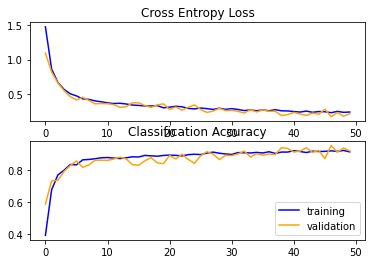

40/40 [==============================] - 0s 3ms/step
0.9293734089327109
0.919329073482428


In [ ]:
#Implementing Model 1 for undersampling testing
#Model adapted from Ma et al. (2021). See https://doi.org/10.1016/j.saa.2021.119732
simple_model = Sequential()

#Add layers
simple_model.add(layers.Conv1D(5, 10, strides = 2, activation='LeakyReLU', input_shape = (1531,1)))
simple_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2))
simple_model.add(layers.Flatten())
simple_model.add(layers.Dense(12, activation='LeakyReLU'))
simple_model.add(layers.Dropout(0.5))
simple_model.add(layers.Dense(6, activation='softmax'))

simple_model.compile(optimizer='adam',
              loss='categorical_crossentropy',
               metrics=['accuracy'])

Undersamp = simple_model.fit(X_under, y_under, epochs=50, batch_size=32, validation_data=(X_val_aug, y_val_aug))
summarize_diagnostics(Undersamp)
y_pred = np.argmax(simple_model.predict(X_val_aug), axis = 1)
print(f1_score(np.argmax(y_val_aug, axis = 1), y_pred , average="macro"))
print(f1_score(np.argmax(y_val_aug, axis = 1), y_pred , average="micro"))

Epoch 1/50
105/105 [==============================] - 2s 7ms/step - loss: 1.3169 - accuracy: 0.4560 - val_loss: 0.9713 - val_accuracy: 0.7045
Epoch 2/50
105/105 [==============================] - 0s 5ms/step - loss: 0.8142 - accuracy: 0.6738 - val_loss: 0.5804 - val_accuracy: 0.8403
Epoch 3/50
105/105 [==============================] - 1s 5ms/step - loss: 0.6036 - accuracy: 0.7661 - val_loss: 0.4432 - val_accuracy: 0.8554
Epoch 4/50
105/105 [==============================] - 1s 5ms/step - loss: 0.5336 - accuracy: 0.7932 - val_loss: 0.3766 - val_accuracy: 0.8690
Epoch 5/50
105/105 [==============================] - 1s 5ms/step - loss: 0.4721 - accuracy: 0.8167 - val_loss: 0.3506 - val_accuracy: 0.8882
Epoch 6/50
105/105 [==============================] - 1s 5ms/step - loss: 0.4654 - accuracy: 0.8196 - val_loss: 0.3423 - val_accuracy: 0.8706
Epoch 7/50
105/105 [==============================] - 0s 5ms/step - loss: 0.4296 - accuracy: 0.8360 - val_loss: 0.3185 - val_accuracy: 0.8842
Epoch 

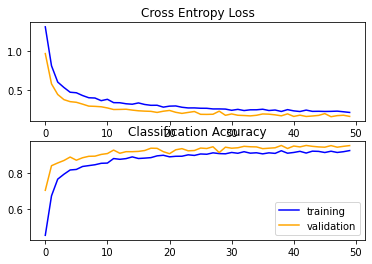

40/40 [==============================] - 0s 4ms/step
0.9575830928493231
0.9512779552715654


In [ ]:
#Implementing Model 1 for oversampling testing
#Model adapted from Ma et al. (2021). See https://doi.org/10.1016/j.saa.2021.119732
simple_model = Sequential()

#Add layers
simple_model.add(layers.Conv1D(5, 10, strides = 2, activation='LeakyReLU', input_shape = (1531,1)))
simple_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2))
simple_model.add(layers.Flatten())
simple_model.add(layers.Dense(12, activation='LeakyReLU'))
simple_model.add(layers.Dropout(0.5))
simple_model.add(layers.Dense(6, activation='softmax'))

simple_model.compile(optimizer='adam',
              loss='categorical_crossentropy',
               metrics=['accuracy'])

Oversamp = simple_model.fit(X_rand_over, y_rand_over, epochs=50, batch_size=32, validation_data=(X_val_aug, y_val_aug))
summarize_diagnostics(Oversamp)
y_pred = np.argmax(simple_model.predict(X_val_aug), axis = 1)
print(f1_score(np.argmax(y_val_aug, axis = 1), y_pred , average="macro"))
print(f1_score(np.argmax(y_val_aug, axis = 1), y_pred , average="micro"))

In [ ]:
#Getting highest validation accuracy of each of the four datasets
#Random Oversampling is found to perform best
Max_oversampling_ac = max(Oversamp.history['accuracy'])
Max_undersampling_ac = max(Undersamp.history['accuracy'])
Max_SMOTE_ac = max(SMOTE_model.history['accuracy'])
Max_no_treatment_ac = max(original_data.history['accuracy'])
Max_oversampling_valac = max(Oversamp.history['val_accuracy'])
Max_undersampling_valac = max(Undersamp.history['val_accuracy'])
Max_SMOTE_valac = max(SMOTE_model.history['val_accuracy'])
Max_no_treatment_valac = max(original_data.history['val_accuracy'])

print('Accuracy: Max_oversampling:', Max_oversampling_ac, 'Max_undersampling:', Max_undersampling_ac, 'SMOTE:', Max_SMOTE_ac, 'Max_no_treatment:', Max_no_treatment_ac)
print('Validation Accuracy: Max_oversampling:', Max_oversampling_valac, 'Max_undersampling:', Max_undersampling_valac, 'SMOTE:', Max_SMOTE_valac, 'Max_no_treatment:', Max_no_treatment_valac)

Accuracy: Max_oversampling: 0.9238095283508301 Max_undersampling: 0.9225806593894958 SMOTE: 0.9184523820877075 Max_no_treatment: 0.9232876896858215
Validation Accuracy: Max_oversampling: 0.9520766735076904 Max_undersampling: 0.9536741375923157 SMOTE: 0.9512779712677002 Max_no_treatment: 0.9472843408584595


In [ ]:
#Implementing Random Oversampling on entire training data
oversample = oversample = RandomOverSampler(sampling_strategy='minority')
X_train_ov, y_train_ov = oversample.fit_resample(X_train, y_train)

In [ ]:
#Initial performance Model 1
#Model adapted from Ma et al. (2021). See https://doi.org/10.1016/j.saa.2021.119732
simple_model = Sequential()

#Add layers
simple_model.add(layers.Conv1D(5, 10, strides = 2, activation='LeakyReLU', input_shape = (1531,1)))
simple_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2))
simple_model.add(layers.Flatten())
simple_model.add(layers.Dense(12, activation='LeakyReLU'))
simple_model.add(layers.Dropout(0.5))
simple_model.add(layers.Dense(6, activation='softmax'))

simple_model.compile(optimizer='adam',
              loss='categorical_crossentropy',
               metrics=['accuracy'])

Simple_model_initial_run = simple_model.fit(X_train_ov, y_train_ov, epochs=50, batch_size=32, validation_data=(X_val, y_val))

Epoch 1/50
150/150 [==============================] - 2s 6ms/step - loss: 1.1385 - accuracy: 0.5608 - val_loss: 0.6295 - val_accuracy: 0.8426
Epoch 2/50
150/150 [==============================] - 1s 5ms/step - loss: 0.6480 - accuracy: 0.7663 - val_loss: 0.3775 - val_accuracy: 0.9002
Epoch 3/50
150/150 [==============================] - 1s 4ms/step - loss: 0.5127 - accuracy: 0.8200 - val_loss: 0.3017 - val_accuracy: 0.9155
Epoch 4/50
150/150 [==============================] - 1s 4ms/step - loss: 0.4454 - accuracy: 0.8331 - val_loss: 0.2693 - val_accuracy: 0.9021
Epoch 5/50
150/150 [==============================] - 1s 5ms/step - loss: 0.4037 - accuracy: 0.8485 - val_loss: 0.2613 - val_accuracy: 0.9021
Epoch 6/50
150/150 [==============================] - 1s 4ms/step - loss: 0.3926 - accuracy: 0.8519 - val_loss: 0.2258 - val_accuracy: 0.9251
Epoch 7/50
150/150 [==============================] - 1s 4ms/step - loss: 0.3482 - accuracy: 0.8723 - val_loss: 0.2173 - val_accuracy: 0.9213
Epoch 

In [ ]:
#Preparing model for tuning
# add input parameters to the function
def Model_1(x_train, y_train, x_val, y_val, params):
    
    simple_model = Sequential()

    #Add layers
    simple_model.add(layers.Conv1D(64, 10, strides = 2, activation='LeakyReLU', input_shape = (1531,1)))
    simple_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2))
    simple_model.add(layers.Flatten())
    simple_model.add(layers.Dense(12, activation='LeakyReLU'))
    simple_model.add(layers.Dense(6, activation='softmax'))

    simple_model.compile(optimizer=params['optimizer'],
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    
    # make sure history object is returned by model.fit()
    out = simple_model.fit(x=x_train, 
                    y=y_train,
                    validation_data=[x_val, y_val],
                    epochs=100,
                    batch_size=32)
    
    # modify the output model
    return out, simple_model

In [ ]:
import talos
#Definine hyperparameter values and tuning values
p = {'optimizer' : ['Adam', 'Nadam', 'RMSprop']}

t = talos.Scan(x=X_train_ov, y=y_train_ov, x_val = X_val, y_val = y_val, params=p, model=Model_1, experiment_name='M1')

  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1/100
150/150 [==============================] - 12s 6ms/step - loss: 0.6110 - accuracy: 0.7656 - val_loss: 0.2809 - val_accuracy: 0.9060
Epoch 2/100
150/150 [==============================] - 1s 4ms/step - loss: 0.2522 - accuracy: 0.9075 - val_loss: 0.2349 - val_accuracy: 0.9155
Epoch 3/100
150/150 [==============================] - 1s 4ms/step - loss: 0.2148 - accuracy: 0.9208 - val_loss: 0.1838 - val_accuracy: 0.9424
Epoch 4/100
150/150 [==============================] - 1s 4ms/step - loss: 0.1887 - accuracy: 0.9310 - val_loss: 0.1725 - val_accuracy: 0.9424
Epoch 5/100
150/150 [==============================] - 1s 4ms/step - loss: 0.1620 - accuracy: 0.9410 - val_loss: 0.1363 - val_accuracy: 0.9520
Epoch 6/100
150/150 [==============================] - 1s 4ms/step - loss: 0.1553 - accuracy: 0.9448 - val_loss: 0.1360 - val_accuracy: 0.9501
Epoch 7/100
150/150 [==============================] - 1s 6ms/step - loss: 0.1410 - accuracy: 0.9488 - val_loss: 0.1614 - val_accuracy: 0.944

 33%|███▎      | 1/3 [01:26<02:52, 86.40s/it]

Epoch 1/100
150/150 [==============================] - 3s 6ms/step - loss: 0.5287 - accuracy: 0.8102 - val_loss: 0.2618 - val_accuracy: 0.9136
Epoch 2/100
150/150 [==============================] - 1s 5ms/step - loss: 0.2255 - accuracy: 0.9225 - val_loss: 0.2181 - val_accuracy: 0.9136
Epoch 3/100
150/150 [==============================] - 1s 5ms/step - loss: 0.1763 - accuracy: 0.9390 - val_loss: 0.1552 - val_accuracy: 0.9463
Epoch 4/100
150/150 [==============================] - 1s 6ms/step - loss: 0.1551 - accuracy: 0.9454 - val_loss: 0.1462 - val_accuracy: 0.9463
Epoch 5/100
150/150 [==============================] - 1s 6ms/step - loss: 0.1421 - accuracy: 0.9494 - val_loss: 0.1339 - val_accuracy: 0.9578
Epoch 6/100
150/150 [==============================] - 1s 7ms/step - loss: 0.1333 - accuracy: 0.9565 - val_loss: 0.1772 - val_accuracy: 0.9328
Epoch 7/100
150/150 [==============================] - 1s 6ms/step - loss: 0.1258 - accuracy: 0.9554 - val_loss: 0.1061 - val_accuracy: 0.9616

 67%|██████▋   | 2/3 [03:49<01:59, 119.90s/it]

Epoch 1/100
150/150 [==============================] - 2s 5ms/step - loss: 0.6430 - accuracy: 0.7623 - val_loss: 0.3622 - val_accuracy: 0.8714
Epoch 2/100
150/150 [==============================] - 1s 4ms/step - loss: 0.3350 - accuracy: 0.8781 - val_loss: 0.3779 - val_accuracy: 0.8292
Epoch 3/100
150/150 [==============================] - 1s 4ms/step - loss: 0.2651 - accuracy: 0.9038 - val_loss: 0.2118 - val_accuracy: 0.9367
Epoch 4/100
150/150 [==============================] - 1s 4ms/step - loss: 0.2226 - accuracy: 0.9187 - val_loss: 0.2288 - val_accuracy: 0.9232
Epoch 5/100
150/150 [==============================] - 1s 4ms/step - loss: 0.1979 - accuracy: 0.9240 - val_loss: 0.1642 - val_accuracy: 0.9443
Epoch 6/100
150/150 [==============================] - 1s 5ms/step - loss: 0.1795 - accuracy: 0.9354 - val_loss: 0.1833 - val_accuracy: 0.9213
Epoch 7/100
150/150 [==============================] - 1s 5ms/step - loss: 0.1641 - accuracy: 0.9381 - val_loss: 0.2858 - val_accuracy: 0.9060

100%|██████████| 3/3 [05:01<00:00, 100.40s/it]


In [ ]:
#Printing the round with the best results for accuracy and validation accuracy
print(analyze_object.rounds2high('accuracy'))
print(analyze_object.rounds2high('val_accuracy'))

             start              end    duration  round_epochs      loss  \
0  03/01/23-064518  03/01/23-064644   86.192622           100  0.049147   
1  03/01/23-064645  03/01/23-064908  143.133135           100  0.043081   
2  03/01/23-064908  03/01/23-065019   71.236402           100  0.054987   

   accuracy  val_loss  val_accuracy optimizer  
0  0.982917  0.048548      0.986564      Adam  
1  0.986250  0.063795      0.980806     Nadam  
2  0.981458  0.071312      0.976967   RMSprop  
0.9862499833106995
0.9865642786026001
1
0
[[86.192622423172 100 '03/01/23-064644' 'Adam' '03/01/23-064518' 0]
 [143.1331353187561 100 '03/01/23-064908' 'Nadam' '03/01/23-064645' 1]
 [71.23640203475952 100 '03/01/23-065019' 'RMSprop' '03/01/23-064908' 2]]
duration        0.083359
round_epochs         NaN
Name: val_accuracy, dtype: float64


In [ ]:
#Combine training and validation set and apply random oversampling to both
X_train_final = pd.concat([X_train, X_val])
y_train_final = np.vstack([y_train, y_val])
oversample = RandomOverSampler(sampling_strategy='minority')
X_train_final_ov, y_train_final_ov = oversample.fit_resample(X_train_final, y_train_final)

In [ ]:
#Get time of final performance
#Adam is retained so the final model statistics stay the same
#Model adapted from Ma et al. (2021). See https://doi.org/10.1016/j.saa.2021.119732
simple_model = Sequential()

#Add layers
simple_model.add(layers.Conv1D(64, 10, strides = 2, activation='LeakyReLU', input_shape = (1531,1)))
simple_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2))
simple_model.add(layers.Flatten())
simple_model.add(layers.Dense(12, activation='LeakyReLU'))
simple_model.add(layers.Dense(6, activation='softmax'))

simple_model.compile(optimizer='adam',
              loss='categorical_crossentropy',
               metrics=['accuracy'])

Model_1_final = simple_model.fit(X_train_final_ov, y_train_final_ov, epochs=100, batch_size=32)

from time import perf_counter
print(len(X_test.index))
start = perf_counter()
result = simple_model.predict(X_test)
end = perf_counter() 
print('total time taken:', end - start)
print('time taken per instance:', (end - start) / len(X_test.index))

Epoch 1/100
169/169 [==============================] - 2s 4ms/step - loss: 0.5781 - accuracy: 0.7891
Epoch 2/100
169/169 [==============================] - 1s 4ms/step - loss: 0.2509 - accuracy: 0.9080
Epoch 3/100
169/169 [==============================] - 1s 5ms/step - loss: 0.1823 - accuracy: 0.9350
Epoch 4/100
169/169 [==============================] - 1s 5ms/step - loss: 0.1763 - accuracy: 0.9352
Epoch 5/100
169/169 [==============================] - 1s 5ms/step - loss: 0.1506 - accuracy: 0.9483
Epoch 6/100
169/169 [==============================] - 1s 5ms/step - loss: 0.1338 - accuracy: 0.9520
Epoch 7/100
169/169 [==============================] - 1s 5ms/step - loss: 0.1326 - accuracy: 0.9544
Epoch 8/100
169/169 [==============================] - 1s 4ms/step - loss: 0.1191 - accuracy: 0.9572
Epoch 9/100
169/169 [==============================] - 1s 4ms/step - loss: 0.1167 - accuracy: 0.9624
Epoch 10/100
169/169 [==============================] - 1s 4ms/step - loss: 0.1136 - accura

In [ ]:
#Get final performance Model 1
#Adam is retained so the final model statistics stay the same
#Model adapted from Ma et al. (2021). See https://doi.org/10.1016/j.saa.2021.119732
simple_model = Sequential()

#Add layers
simple_model.add(layers.Conv1D(64, 10, strides = 2, activation='LeakyReLU', input_shape = (1531,1)))
simple_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2))
simple_model.add(layers.Flatten())
simple_model.add(layers.Dense(12, activation='LeakyReLU'))
simple_model.add(layers.Dense(6, activation='softmax'))

simple_model.compile(optimizer='adam',
              loss='categorical_crossentropy',
               metrics=['accuracy'])

Model_1_final = simple_model.fit(X_train_final_ov, y_train_final_ov, epochs=100, batch_size=32, validation_data=(X_test, y_test))

Epoch 1/100
169/169 [==============================] - 2s 6ms/step - loss: 0.5715 - accuracy: 0.7757 - val_loss: 0.3302 - val_accuracy: 0.8755
Epoch 2/100
169/169 [==============================] - 1s 5ms/step - loss: 0.2496 - accuracy: 0.9098 - val_loss: 0.3088 - val_accuracy: 0.8793
Epoch 3/100
169/169 [==============================] - 1s 5ms/step - loss: 0.2101 - accuracy: 0.9267 - val_loss: 0.2564 - val_accuracy: 0.9119
Epoch 4/100
169/169 [==============================] - 1s 5ms/step - loss: 0.1788 - accuracy: 0.9346 - val_loss: 0.2399 - val_accuracy: 0.9119
Epoch 5/100
169/169 [==============================] - 1s 5ms/step - loss: 0.1625 - accuracy: 0.9419 - val_loss: 0.1830 - val_accuracy: 0.9425
Epoch 6/100
169/169 [==============================] - 1s 5ms/step - loss: 0.1599 - accuracy: 0.9420 - val_loss: 0.1672 - val_accuracy: 0.9502
Epoch 7/100
169/169 [==============================] - 1s 6ms/step - loss: 0.1416 - accuracy: 0.9485 - val_loss: 0.1837 - val_accuracy: 0.9368

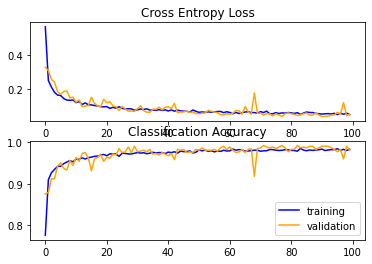

17/17 [==============================] - 0s 2ms/step


<ipython-input-12-2b53ccca8e16>:40: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


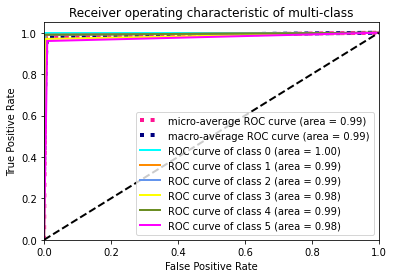

17/17 [==============================] - 0s 2ms/step
[[22  0  0  0  0  0]
 [ 0 99  0  0  0  1]
 [ 0  0 99  0  0  1]
 [ 0  0  2 97  0  1]
 [ 0  0  0  0 99  1]
 [ 0  3  0  1  0 96]]
validation_accuracy: 0.981


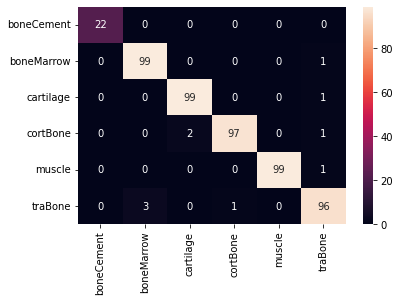

Sensitivity validation set: [1.   0.99 0.99 0.97 0.99 0.96]
Specificity validation set: [1.         0.992891   0.99526066 0.99763033 1.         0.99052133]
F1 validation set: [1.         0.98019802 0.98507463 0.97979798 0.99497487 0.96      ]
Average sensitivity validation set: 0.9833333333333334
Average specificity validation set: 0.9960505529225907
Average F1 validation set: 0.9833409168062484


In [ ]:
#Get Visuals and performance metrics final run model 1
summarize_diagnostics(Model_1_final)
#ROC + AUC for validation set based on model 1:
lw = 2
#Get true classes
true_classes = np.array(y_test)
#Get predicted classes
predict_x = simple_model.predict(X_test)
predicted_classes_x = []
for l in predict_x:
  multi_array = np.zeros(6)
  x = l.argmax()
  multi_array[x] = 1
  predicted_classes_x.append(multi_array)

predicted_classes_x = np.array(predicted_classes_x)

class_names = np.unique(y)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
n_classes = 6
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(true_classes[:, i], predicted_classes_x[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(true_classes.ravel(), predicted_classes_x.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and AUC

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(1)
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = cycle(['aqua', 'darkorange', 'cornflowerblue', 'yellow', 'olivedrab', 'magenta'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic of multi-class')
plt.legend(loc="lower right")
plt.show("lower right")

#Test Accuracy and Confusion Matrix:
#Predict for v
y_pred = simple_model.predict(X_test)
confusion_matrix = sklearn.metrics.confusion_matrix(y_test.argmax(axis=1), np.rint(y_pred.argmax(axis=1)))
print(confusion_matrix)
acc = accuracy_score((y_test.argmax(axis=1)), y_pred.argmax(axis=1))
print('validation_accuracy: %.3f' % (acc))

DetaFrame_cm = pd.DataFrame(confusion_matrix, range(6), range(6))
snNew.heatmap(DetaFrame_cm, annot=True, yticklabels=['boneCement', 'boneMarrow', 'cartilage', 'cortBone', 'muscle',
       'traBone'], xticklabels=['boneCement', 'boneMarrow', 'cartilage', 'cortBone', 'muscle',
       'traBone'])
plt.show()

#Specificity and Sensitivity for each class:
FP = confusion_matrix.sum(axis=0) - np.diag(confusion_matrix) 
FN = confusion_matrix.sum(axis=1) - np.diag(confusion_matrix)
TP = np.diag(confusion_matrix)
TN = confusion_matrix.sum() - (FP + FN + TP)
FP = FP.astype(float)
FN = FN.astype(float)
TP = TP.astype(float)
TN = TN.astype(float)
# Sensitivity, hit rate, recall, or true positive rate
TPR = TP/(TP+FN)
#Average sensitivity
avTPR = sum(TPR) / len(TPR)
# Specificity or true negative rate
TNR = TN/(TN+FP)
#Average Specificity
avTNR = sum(TNR) / len(TNR)
#Precision
P = TP / (TP + FP)
#F1 score
F1 = 2*(P*TPR / (P + TPR))
#Average F1
avF1 = sum(F1) / len(F1)
print('Sensitivity validation set:', TPR)
print('Specificity validation set:', TNR)
print('F1 validation set:', F1)
print('Average sensitivity validation set:', avTPR)
print('Average specificity validation set:', avTNR)
print('Average F1 validation set:', avF1)

In [ ]:
#Implementing Model 2
#Complex Model
#Model adapted from Yu et al. (2019). See https://doi.org/10.1016/j.pdpdt.2019.05.008
complex_model = Sequential()

#Add layers
complex_model.add(layers.Conv1D(16, 9, 1, activation='ReLU', padding = 'same', input_shape = (1531,1)))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(32, 5, 1, activation='ReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(64, 3, 1, activation='ReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(128, 3, 1, activation='ReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(256, 3, 1, activation='ReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(256, 3, 1, activation='ReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Flatten())
complex_model.add(layers.Dense(12, activation='ReLU'))
complex_model.add(layers.Dropout(0.5))
complex_model.add(layers.Dense(6, activation='softmax'))
complex_model.summary()

complex_model.compile(optimizer='adam',
              loss='categorical_crossentropy',
               metrics=['accuracy'])

Model_2_initial = complex_model.fit(X_train_ov, y_train_ov, epochs=50, batch_size=32, validation_data=(X_val, y_val))

Model: "sequential_47"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d_102 (Conv1D)         (None, 1531, 16)          160       
                                                                 
 max_pooling1d_102 (MaxPooli  (None, 766, 16)          0         
 ng1D)                                                           
                                                                 
 conv1d_103 (Conv1D)         (None, 766, 32)           2592      
                                                                 
 max_pooling1d_103 (MaxPooli  (None, 383, 32)          0         
 ng1D)                                                           
                                                                 
 conv1d_104 (Conv1D)         (None, 383, 64)           6208      
                                                                 
 max_pooling1d_104 (MaxPooli  (None, 192, 64)        

In [ ]:
#Implement hyperparameter tuning with Talos for complex Model
#Preparing model for tuning
# add input parameters to the function
def Model_2(x_train, y_train, x_val, y_val, params):
    
    complex_model = Sequential()

    #Add layers
    complex_model.add(layers.Conv1D(16, 3, 1, activation='LeakyReLU', padding = 'same', input_shape = (1531,1)))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Conv1D(32, 3, 1, activation='LeakyReLU', padding = 'same'))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Conv1D(64, 3, 1, activation='LeakyReLU', padding = 'same'))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Conv1D(128, 3, 1, activation='LeakyReLU', padding = 'same'))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Conv1D(256, 3, 1, activation='LeakyReLU', padding = 'same'))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Conv1D(256, 3, 1, activation='LeakyReLU', padding = 'same'))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Flatten())
    complex_model.add(layers.Dense(12, activation='LeakyReLU'))
    complex_model.add(layers.Dense(6, activation='softmax'))

    complex_model.compile(optimizer=params['optimizer'],
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    
    # make sure history object is returned by model.fit()
    out = complex_model.fit(x=x_train, 
                    y=y_train,
                    validation_data=[x_val, y_val],
                    epochs=200,
                    batch_size=64)
    
    # modify the output model
    return out, complex_model


In [ ]:
import talos
import numpy as np
#Definine hyperparameter values and tuning values
p = {'optimizer' : ['Adam', 'Nadam', 'RMSprop']}

t = talos.Scan(x=X_train_ov, y=y_train_ov, x_val = X_val, y_val = y_val, params=p, model=Model_2, experiment_name='M2')

  0%|          | 0/3 [00:00<?, ?it/s]

Epoch 1/200
75/75 [==============================] - 8s 24ms/step - loss: 0.7518 - accuracy: 0.6948 - val_loss: 0.5049 - val_accuracy: 0.7869
Epoch 2/200
75/75 [==============================] - 1s 12ms/step - loss: 0.2584 - accuracy: 0.9054 - val_loss: 0.2690 - val_accuracy: 0.9040
Epoch 3/200
75/75 [==============================] - 1s 12ms/step - loss: 0.1874 - accuracy: 0.9365 - val_loss: 0.1786 - val_accuracy: 0.9386
Epoch 4/200
75/75 [==============================] - 1s 12ms/step - loss: 0.1742 - accuracy: 0.9373 - val_loss: 0.1871 - val_accuracy: 0.9463
Epoch 5/200
75/75 [==============================] - 1s 12ms/step - loss: 0.1571 - accuracy: 0.9456 - val_loss: 0.1208 - val_accuracy: 0.9635
Epoch 6/200
75/75 [==============================] - 1s 12ms/step - loss: 0.1285 - accuracy: 0.9535 - val_loss: 0.1197 - val_accuracy: 0.9578
Epoch 7/200
75/75 [==============================] - 1s 15ms/step - loss: 0.1298 - accuracy: 0.9529 - val_loss: 0.1038 - val_accuracy: 0.9731
Epoch 

 33%|███▎      | 1/3 [03:24<06:49, 204.99s/it]

Epoch 1/200
75/75 [==============================] - 7s 19ms/step - loss: 0.6727 - accuracy: 0.7387 - val_loss: 0.3786 - val_accuracy: 0.8580
Epoch 2/200
75/75 [==============================] - 1s 14ms/step - loss: 0.2122 - accuracy: 0.9271 - val_loss: 0.1575 - val_accuracy: 0.9463
Epoch 3/200
75/75 [==============================] - 1s 14ms/step - loss: 0.1563 - accuracy: 0.9471 - val_loss: 0.1558 - val_accuracy: 0.9501
Epoch 4/200
75/75 [==============================] - 1s 14ms/step - loss: 0.1465 - accuracy: 0.9535 - val_loss: 0.1323 - val_accuracy: 0.9463
Epoch 5/200
75/75 [==============================] - 1s 14ms/step - loss: 0.1347 - accuracy: 0.9552 - val_loss: 0.1046 - val_accuracy: 0.9712
Epoch 6/200
75/75 [==============================] - 1s 14ms/step - loss: 0.1093 - accuracy: 0.9650 - val_loss: 0.0953 - val_accuracy: 0.9712
Epoch 7/200
75/75 [==============================] - 1s 14ms/step - loss: 0.1127 - accuracy: 0.9640 - val_loss: 0.0935 - val_accuracy: 0.9750
Epoch 

 67%|██████▋   | 2/3 [07:50<04:00, 240.39s/it]

Epoch 1/200
75/75 [==============================] - 4s 18ms/step - loss: 0.9567 - accuracy: 0.6173 - val_loss: 0.4627 - val_accuracy: 0.8599
Epoch 2/200
75/75 [==============================] - 1s 12ms/step - loss: 0.3559 - accuracy: 0.8679 - val_loss: 0.2416 - val_accuracy: 0.9232
Epoch 3/200
75/75 [==============================] - 1s 12ms/step - loss: 0.2341 - accuracy: 0.9119 - val_loss: 0.2048 - val_accuracy: 0.9021
Epoch 4/200
75/75 [==============================] - 1s 12ms/step - loss: 0.2065 - accuracy: 0.9300 - val_loss: 0.1605 - val_accuracy: 0.9405
Epoch 5/200
75/75 [==============================] - 1s 12ms/step - loss: 0.1788 - accuracy: 0.9344 - val_loss: 0.1428 - val_accuracy: 0.9443
Epoch 6/200
75/75 [==============================] - 1s 15ms/step - loss: 0.1666 - accuracy: 0.9379 - val_loss: 0.1586 - val_accuracy: 0.9309
Epoch 7/200
75/75 [==============================] - 1s 14ms/step - loss: 0.1545 - accuracy: 0.9463 - val_loss: 0.1464 - val_accuracy: 0.9463
Epoch 

100%|██████████| 3/3 [11:04<00:00, 221.49s/it]


In [ ]:
# get the round with the best result
print(analyze_object.rounds2high('accuracy'))
print(analyze_object.rounds2high('val_accuracy'))

             start              end    duration  round_epochs      loss  \
0  03/01/23-065255  03/01/23-065620  204.763102           200  0.020499   
1  03/01/23-065620  03/01/23-070045  264.912199           200  0.023010   
2  03/01/23-070045  03/01/23-070359  194.035843           200  0.018895   

   accuracy  val_loss  val_accuracy optimizer  
0  0.993333  0.041770      0.992322      Adam  
1  0.992708  0.060495      0.984645     Nadam  
2  0.994167  0.060870      0.986564   RMSprop  
0.9941666722297668
0.9923224449157715
2
0
[[204.76310229301453 200 '03/01/23-065620' 'Adam' '03/01/23-065255' 0]
 [194.03584265708923 200 '03/01/23-070359' 'RMSprop' '03/01/23-070045' 1]
 [264.91219902038574 200 '03/01/23-070045' 'Nadam' '03/01/23-065620' 2]]
duration       -0.585337
round_epochs         NaN
Name: val_accuracy, dtype: float64


In [ ]:
#Final time Model 2
complex_model = Sequential()

#Add layers
complex_model.add(layers.Conv1D(16, 3, 1, activation='LeakyReLU', padding = 'same', input_shape = (1531,1)))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(32, 3, 1, activation='LeakyReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(64, 3, 1, activation='LeakyReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(128, 3, 1, activation='LeakyReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(256, 3, 1, activation='LeakyReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(256, 3, 1, activation='LeakyReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Flatten())
complex_model.add(layers.Dense(12, activation='LeakyReLU'))
complex_model.add(layers.Dense(6, activation='softmax'))

complex_model.compile(optimizer='Adam',
              loss='categorical_crossentropy',
               metrics=['accuracy'])

Model_2_final = complex_model.fit(X_train_final_ov, y_train_final_ov, epochs=150, batch_size=64)

from time import perf_counter
print(len(X_test.index))
start = perf_counter()
result = complex_model.predict(X_test)
end = perf_counter() 
print('total time taken:', end - start)
print('time taken per instance:', (end - start) / len(X_test.index))

Epoch 1/150
85/85 [==============================] - 4s 13ms/step - loss: 0.6463 - accuracy: 0.7348
Epoch 2/150
85/85 [==============================] - 1s 11ms/step - loss: 0.2273 - accuracy: 0.9163
Epoch 3/150
85/85 [==============================] - 1s 11ms/step - loss: 0.1950 - accuracy: 0.9311
Epoch 4/150
85/85 [==============================] - 1s 11ms/step - loss: 0.1649 - accuracy: 0.9443
Epoch 5/150
85/85 [==============================] - 1s 11ms/step - loss: 0.1438 - accuracy: 0.9543
Epoch 6/150
85/85 [==============================] - 1s 11ms/step - loss: 0.1333 - accuracy: 0.9539
Epoch 7/150
85/85 [==============================] - 1s 11ms/step - loss: 0.1204 - accuracy: 0.9585
Epoch 8/150
85/85 [==============================] - 1s 12ms/step - loss: 0.1084 - accuracy: 0.9622
Epoch 9/150
85/85 [==============================] - 1s 13ms/step - loss: 0.1036 - accuracy: 0.9641
Epoch 10/150
85/85 [==============================] - 1s 13ms/step - loss: 0.1124 - accuracy: 0.9617

In [ ]:
#Final performance Model 2
complex_model = Sequential()

#Add layers
complex_model.add(layers.Conv1D(16, 3, 1, activation='LeakyReLU', padding = 'same', input_shape = (1531,1)))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(32, 3, 1, activation='LeakyReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(64, 3, 1, activation='LeakyReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(128, 3, 1, activation='LeakyReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(256, 3, 1, activation='LeakyReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Conv1D(256, 3, 1, activation='LeakyReLU', padding = 'same'))
complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
complex_model.add(layers.Flatten())
complex_model.add(layers.Dense(12, activation='LeakyReLU'))
complex_model.add(layers.Dense(6, activation='softmax'))

complex_model.compile(optimizer='Adam',
              loss='categorical_crossentropy',
               metrics=['accuracy'])

Model_2_final = complex_model.fit(X_train_final_ov, y_train_final_ov, epochs=150, batch_size=64, validation_data=(X_test, y_test))

Epoch 1/150
85/85 [==============================] - 5s 18ms/step - loss: 0.6725 - accuracy: 0.7317 - val_loss: 0.2914 - val_accuracy: 0.8831
Epoch 2/150
85/85 [==============================] - 1s 13ms/step - loss: 0.2328 - accuracy: 0.9144 - val_loss: 0.2169 - val_accuracy: 0.9176
Epoch 3/150
85/85 [==============================] - 1s 13ms/step - loss: 0.1756 - accuracy: 0.9389 - val_loss: 0.1997 - val_accuracy: 0.9310
Epoch 4/150
85/85 [==============================] - 1s 13ms/step - loss: 0.1559 - accuracy: 0.9454 - val_loss: 0.1955 - val_accuracy: 0.9253
Epoch 5/150
85/85 [==============================] - 1s 12ms/step - loss: 0.1411 - accuracy: 0.9517 - val_loss: 0.1467 - val_accuracy: 0.9540
Epoch 6/150
85/85 [==============================] - 1s 12ms/step - loss: 0.1241 - accuracy: 0.9596 - val_loss: 0.1182 - val_accuracy: 0.9579
Epoch 7/150
85/85 [==============================] - 1s 13ms/step - loss: 0.1441 - accuracy: 0.9541 - val_loss: 0.1630 - val_accuracy: 0.9464
Epoch 

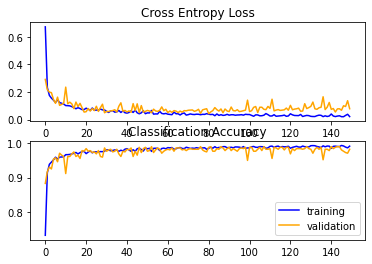

17/17 [==============================] - 0s 4ms/step


<ipython-input-16-e7d5b37baa8e>:40: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


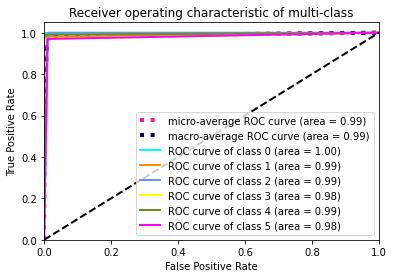

17/17 [==============================] - 0s 5ms/step
[[ 22   0   0   0   0   0]
 [  0  98   0   0   0   2]
 [  0   0 100   0   0   0]
 [  0   0   2  97   0   1]
 [  0   0   0   0  99   1]
 [  0   0   3   0   0  97]]
validation_accuracy: 0.983


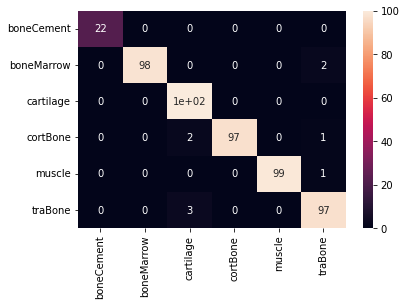

Sensitivity validation set: [1.   0.98 1.   0.97 0.99 0.97]
Specificity validation set: [1.         1.         0.98815166 1.         1.         0.99052133]
F1 validation set: [1.         0.98989899 0.97560976 0.98477157 0.99497487 0.96517413]
Average sensitivity validation set: 0.985
Average specificity validation set: 0.9964454976303317
Average F1 validation set: 0.9850715538876176


In [ ]:
summarize_diagnostics(Model_2_final)
#ROC + AUC for validation set based on model 1:
lw = 2
#Get true classes
true_classes = np.array(y_test)
#Get predicted classes
predict_x = complex_model.predict(X_test)
predicted_classes_x = []
for l in predict_x:
  multi_array = np.zeros(6)
  x = l.argmax()
  multi_array[x] = 1
  predicted_classes_x.append(multi_array)

predicted_classes_x = np.array(predicted_classes_x)

class_names = np.unique(y)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
n_classes = 6
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(true_classes[:, i], predicted_classes_x[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(true_classes.ravel(), predicted_classes_x.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and AUC

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(1)
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = cycle(['aqua', 'darkorange', 'cornflowerblue', 'yellow', 'olivedrab', 'magenta'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic of multi-class')
plt.legend(loc="lower right")
plt.show("lower right")

#Test Accuracy and Confusion Matrix:
#Predict for v
y_pred = complex_model.predict(X_test)
confusion_matrix = sklearn.metrics.confusion_matrix(y_test.argmax(axis=1), np.rint(y_pred.argmax(axis=1)))
print(confusion_matrix)
acc = accuracy_score((y_test.argmax(axis=1)), y_pred.argmax(axis=1))
print('validation_accuracy: %.3f' % (acc))

DetaFrame_cm = pd.DataFrame(confusion_matrix, range(6), range(6))
snNew.heatmap(DetaFrame_cm, annot=True, yticklabels=['boneCement', 'boneMarrow', 'cartilage', 'cortBone', 'muscle',
       'traBone'], xticklabels=['boneCement', 'boneMarrow', 'cartilage', 'cortBone', 'muscle',
       'traBone'])
plt.show()

#Specificity and Sensitivity for each class:
FP = confusion_matrix.sum(axis=0) - np.diag(confusion_matrix) 
FN = confusion_matrix.sum(axis=1) - np.diag(confusion_matrix)
TP = np.diag(confusion_matrix)
TN = confusion_matrix.sum() - (FP + FN + TP)
FP = FP.astype(float)
FN = FN.astype(float)
TP = TP.astype(float)
TN = TN.astype(float)
# Sensitivity, hit rate, recall, or true positive rate
TPR = TP/(TP+FN)
#Average sensitivity
avTPR = sum(TPR) / len(TPR)
# Specificity or true negative rate
TNR = TN/(TN+FP)
#Average Specificity
avTNR = sum(TNR) / len(TNR)
#Precision
P = TP / (TP + FP)
#F1 score
F1 = 2*(P*TPR / (P + TPR))
#Average F1
avF1 = sum(F1) / len(F1)
print('Sensitivity validation set:', TPR)
print('Specificity validation set:', TNR)
print('F1 validation set:', F1)
print('Average sensitivity validation set:', avTPR)
print('Average specificity validation set:', avTNR)
print('Average F1 validation set:', avF1)

In [ ]:
#Integrating Grad_CAM
#Code partially adapted from https://www.kaggle.com/code/bjoernjostein/clf-and-exp-arrhythmia-from-rr-int-using-cnn/notebook
#Changing model implementation to allow visualization generation
def Model_2():
    
    complex_model = Sequential()

    #Add layers
    complex_model.add(layers.Conv1D(16, 3, 1, activation='LeakyReLU', padding = 'same', input_shape = (1531,1)))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Conv1D(32, 3, 1, activation='LeakyReLU', padding = 'same'))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Conv1D(64, 3, 1, activation='LeakyReLU', padding = 'same'))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Conv1D(128, 3, 1, activation='LeakyReLU', padding = 'same'))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Conv1D(256, 3, 1, activation='LeakyReLU', padding = 'same'))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Conv1D(256, 3, 1, activation='LeakyReLU', padding = 'same'))
    complex_model.add(layers.MaxPooling1D(pool_size = 2, strides = 2, padding = 'same'))
    complex_model.add(layers.Flatten())
    complex_model.add(layers.Dense(12, activation='LeakyReLU'))
    complex_model.add(layers.Dense(6, activation='softmax'))

    complex_model.compile(optimizer='Adam',
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    return complex_model

model2 = Model_2()
model2.fit(x = X_train_final_ov, y=y_train_final_ov,batch_size=64,epochs=150)
pred = model2.predict(X_test)

Epoch 1/150
85/85 [==============================] - 20s 27ms/step - loss: 0.6521 - accuracy: 0.7291
Epoch 2/150
85/85 [==============================] - 1s 11ms/step - loss: 0.2234 - accuracy: 0.9206
Epoch 3/150
85/85 [==============================] - 1s 11ms/step - loss: 0.1675 - accuracy: 0.9431
Epoch 4/150
85/85 [==============================] - 1s 11ms/step - loss: 0.1633 - accuracy: 0.9457
Epoch 5/150
85/85 [==============================] - 1s 11ms/step - loss: 0.1529 - accuracy: 0.9452
Epoch 6/150
85/85 [==============================] - 1s 11ms/step - loss: 0.1371 - accuracy: 0.9520
Epoch 7/150
85/85 [==============================] - 1s 12ms/step - loss: 0.1223 - accuracy: 0.9578
Epoch 8/150
85/85 [==============================] - 1s 12ms/step - loss: 0.1119 - accuracy: 0.9620
Epoch 9/150
85/85 [==============================] - 1s 13ms/step - loss: 0.1079 - accuracy: 0.9639
Epoch 10/150
85/85 [==============================] - 1s 12ms/step - loss: 0.1000 - accuracy: 0.966

In [ ]:
#Creating list of samples in correct order
y_test_dec = []
for item in y_test:
  y_test_dec.append((np.argmax(item, axis = 0)))

y_test_decoded = le.inverse_transform(y_test_dec)

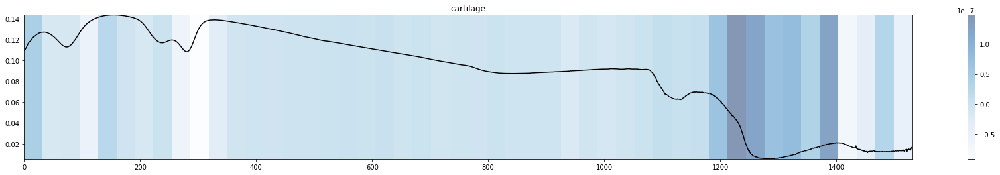

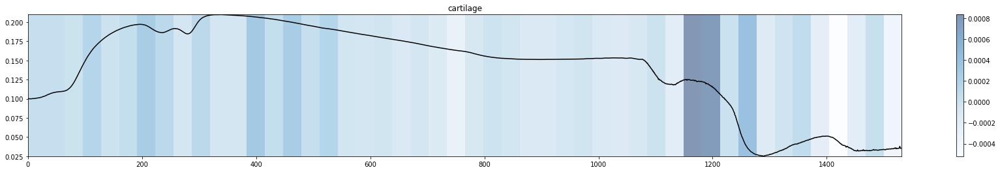

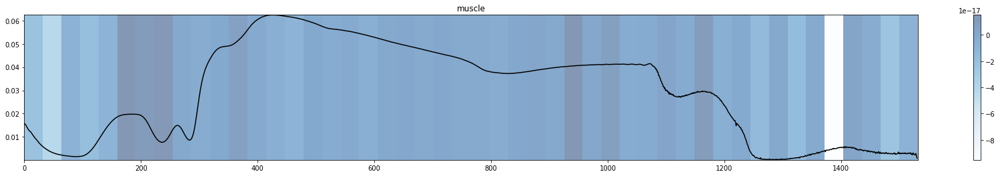

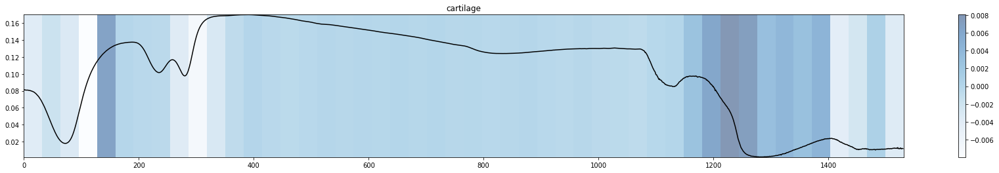

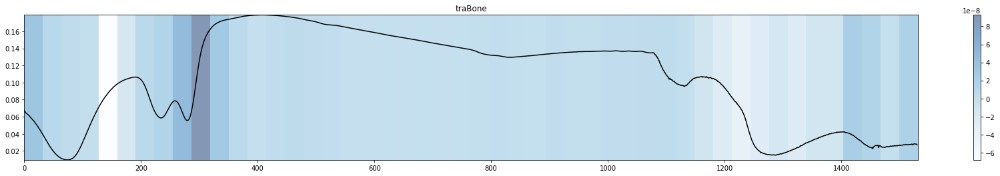

...

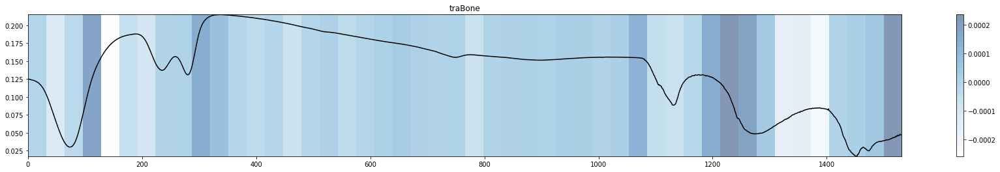

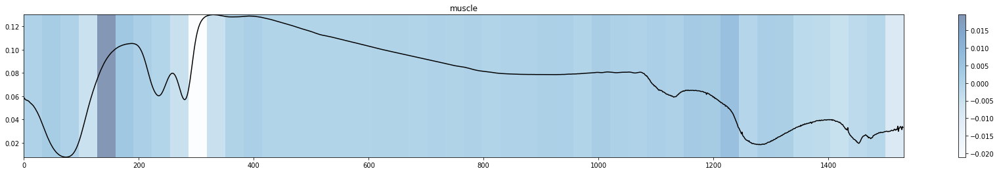

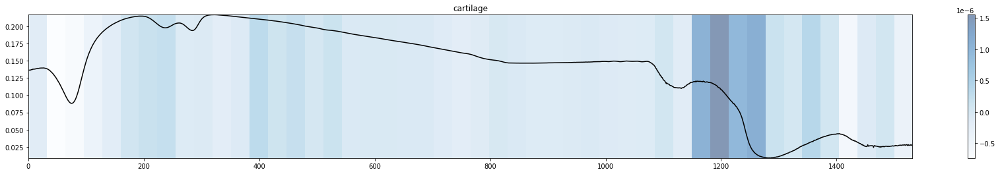

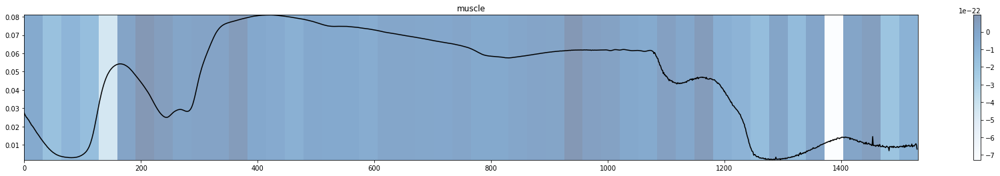

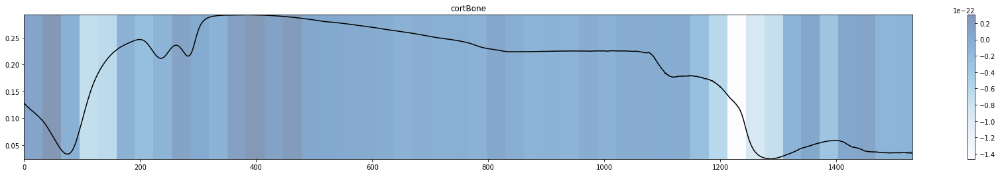

In [ ]:
#Code partly adapted from https://www.kaggle.com/code/bjoernjostein/clf-and-exp-arrhythmia-from-rr-int-using-cnn/notebook
def grad_cam(layer_name, data):
    grad_model = tf.keras.models.Model([model2.inputs], [model2.get_layer(layer_name).output, model2.output])
    last_conv_layer_output, preds = grad_model(data)
    
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(data)
        pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]
        
    grads = tape.gradient(class_channel, last_conv_layer_output)
    
    pooled_grads = tf.reduce_mean(grads, axis=(0))
    
    last_conv_layer_output = last_conv_layer_output[0]
    
    heatmap = last_conv_layer_output * pooled_grads
    heatmap = tf.reduce_mean(heatmap, axis=(1))
    heatmap = np.expand_dims(heatmap,0)
    return heatmap

#Generating visualizations for test set and appending to heatmap
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

layer_name = "conv1d_5"
label = [0, 1, 2, 3, 4, 5]
heatmap_list = []
X_test = np.array(X_test)
for clas, i in zip(y_test_decoded, X_test):
    data = np.expand_dims(i,0)
    heatmap = grad_cam(layer_name, data)
    heatmap_list.append(heatmap)
    plt.figure(figsize=(30,4))
    plt.imshow(np.expand_dims(heatmap,axis=2),cmap='Blues', aspect="auto", interpolation='nearest',extent=[0,1531,i.min(),i.max()], alpha=0.5)
    plt.plot(i,'k')
    plt.colorbar()
    plt.title(str(clas))
    plt.show()

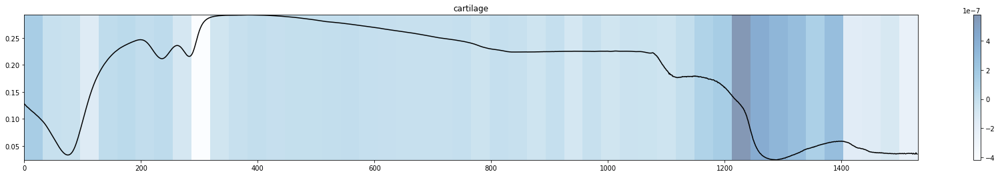

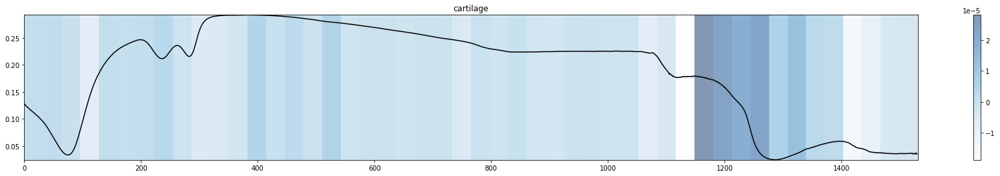

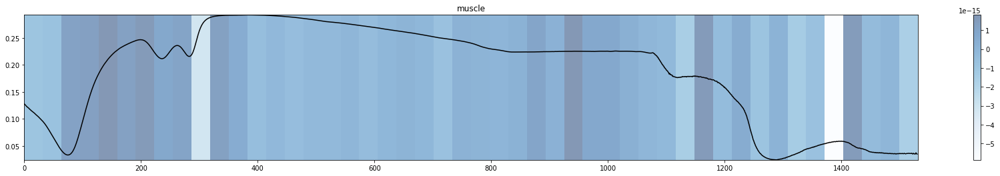

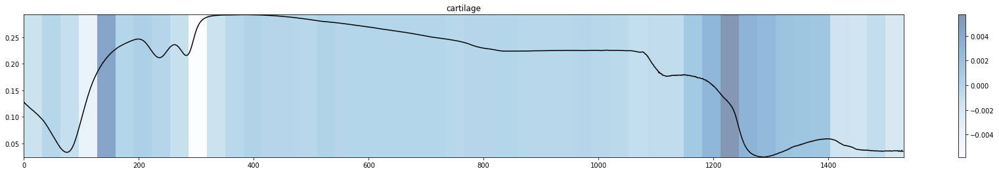

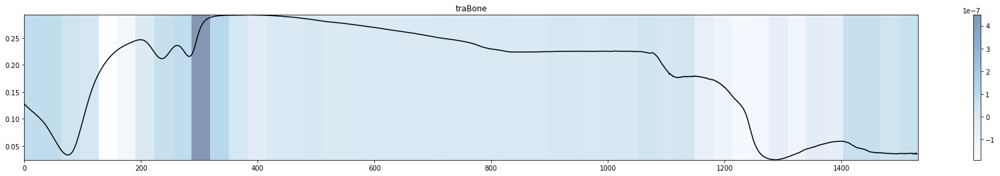

...

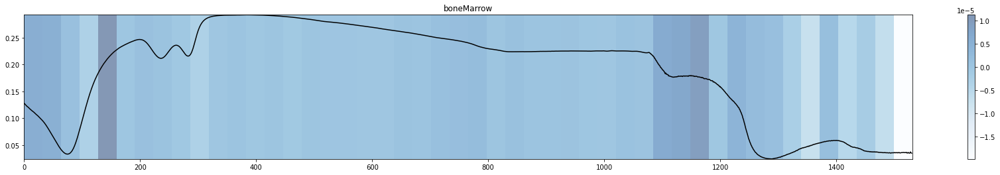

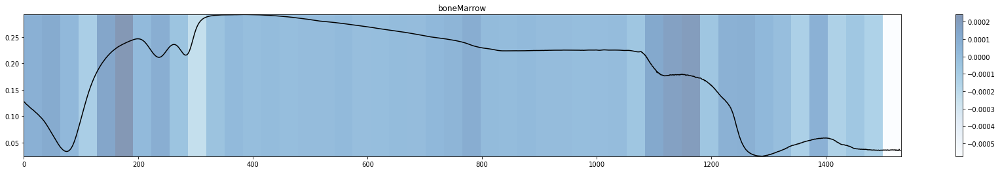

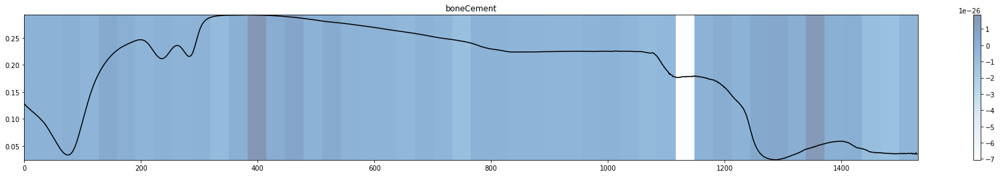

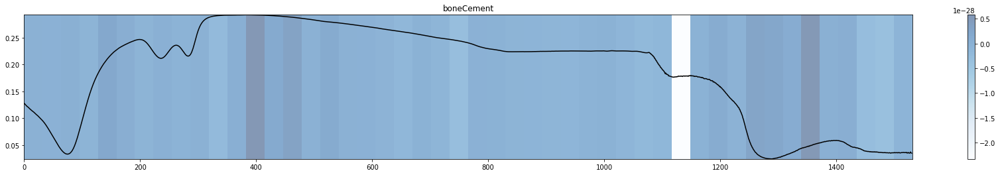

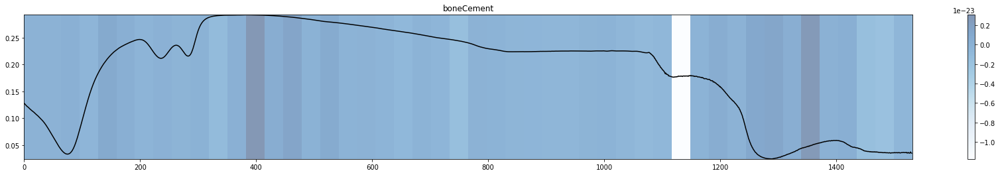

In [ ]:
#Getting predictions for first five instances each class
class_dict = {}
for clas, item in zip(y_test_decoded, heatmap_list):
    if clas in class_dict:
      if class_dict[clas] < 5:
        plt.figure(figsize=(30,4))
        plt.imshow(np.expand_dims(item,axis=2),cmap='Blues', aspect="auto", interpolation='nearest',extent=[0,1531,i.min(),i.max()], alpha=0.5)
        plt.plot(i,'k')
        plt.colorbar()
        plt.title(str(clas))
        plt.show()
        class_dict[clas] += 1
      elif class_dict[clas] >= 5:
        continue
    else:
      plt.figure(figsize=(30,4))
      plt.imshow(np.expand_dims(item,axis=2),cmap='Blues', aspect="auto", interpolation='nearest',extent=[0,1531,i.min(),i.max()], alpha=0.5)
      plt.plot(i,'k')
      plt.colorbar()
      class_dict[clas] = 1
      plt.title(str(clas))
      plt.show()

In [ ]:
#DenseNet 121 model adapted according to specification by Jahmunaha et al. (2022)
#Code adapted from https://github.com/ankitvgupta/densenet_1d
dense_net_model = DenseNet121(input_shape=(1531,1), num_outputs = 6, k = 8, conv_kernel_width = 10, 
                    bottleneck_size = 0.125, transition_pool_size = 2,
                    transition_pool_stride = 2, theta = 1, 
                    initial_conv_width = 1, initial_stride = 2,
                    initial_filters = 64, initial_pool_width = 2,
                    initial_pool_stride = 2)

dense_net_model.compile(optimizer='Adamax',
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

Dense_initial = dense_net_model.fit(X_train_ov, y_train_ov, epochs=20, batch_size=32, validation_data=(X_val, y_val))

Epoch 1/20
150/150 [==============================] - 147s 184ms/step - loss: 0.5400 - accuracy: 0.8146 - val_loss: 2.1176 - val_accuracy: 0.1919
Epoch 2/20
150/150 [==============================] - 21s 142ms/step - loss: 0.3009 - accuracy: 0.9025 - val_loss: 3.5102 - val_accuracy: 0.1919
Epoch 3/20
150/150 [==============================] - 24s 157ms/step - loss: 0.2263 - accuracy: 0.9265 - val_loss: 3.8938 - val_accuracy: 0.1939
Epoch 4/20
150/150 [==============================] - 22s 147ms/step - loss: 0.1797 - accuracy: 0.9446 - val_loss: 1.7162 - val_accuracy: 0.4050
Epoch 5/20
150/150 [==============================] - 21s 143ms/step - loss: 0.1710 - accuracy: 0.9450 - val_loss: 1.4909 - val_accuracy: 0.5413
Epoch 6/20
150/150 [==============================] - 23s 151ms/step - loss: 0.1592 - accuracy: 0.9492 - val_loss: 0.7141 - val_accuracy: 0.7466
Epoch 7/20
150/150 [==============================] - 21s 140ms/step - loss: 0.1383 - accuracy: 0.9575 - val_loss: 1.5149 - val_a

In [ ]:
#Final run on test data
#DenseNet 121 model adapted according to specification by Jahmunaha et al. (2022)
#Code adapted from https://github.com/ankitvgupta/densenet_1d
from densenet.classifiers.one_d import DenseNet121
dense_net_model = DenseNet121(input_shape=(1531,1), num_outputs = 6, k = 8, conv_kernel_width = 10, 
                    bottleneck_size = 0.125, transition_pool_size = 2,
                    transition_pool_stride = 4, theta = 1, 
                    initial_conv_width = 1, initial_stride = 4,
                    initial_filters = 8, initial_pool_width = 2,
                    initial_pool_stride = 2)

dense_net_model.compile(optimizer='Adamax',
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

start_mod = perf_counter()
Dense_initial = dense_net_model.fit(X_train_final_ov, y_train_final_ov, epochs=20, batch_size=32)
end_mod = perf_counter() 


from time import perf_counter
print(len(X_test.index))
start = perf_counter()
result = dense_net_model.predict(X_test)
end = perf_counter() 
print('total time taken:', end - start)
print('time taken per instance:', (end - start) / len(X_test.index))
print('total time taken_model:', end_mod - start_mod)
print('time taken model per instance:', (end_mod - start_mod) / 20)

Epoch 1/20
169/169 [==============================] - 126s 183ms/step - loss: 0.3131 - accuracy: 0.8937
Epoch 2/20
169/169 [==============================] - 32s 188ms/step - loss: 0.1754 - accuracy: 0.9452
Epoch 3/20
169/169 [==============================] - 30s 180ms/step - loss: 0.1293 - accuracy: 0.9578
Epoch 4/20
169/169 [==============================] - 31s 181ms/step - loss: 0.1260 - accuracy: 0.9535
Epoch 5/20
169/169 [==============================] - 32s 187ms/step - loss: 0.1067 - accuracy: 0.9644
Epoch 6/20
169/169 [==============================] - 32s 187ms/step - loss: 0.1053 - accuracy: 0.9654
Epoch 7/20
169/169 [==============================] - 31s 181ms/step - loss: 0.0985 - accuracy: 0.9681
Epoch 8/20
169/169 [==============================] - 31s 182ms/step - loss: 0.0925 - accuracy: 0.9670
Epoch 9/20
169/169 [==============================] - 32s 189ms/step - loss: 0.0941 - accuracy: 0.9689
Epoch 10/20
169/169 [==============================] - 31s 182ms/step - 

In [ ]:
#Final run on test data
#DenseNet 121 model adapted according to specification by Jahmunaha et al. (2022)
#Code adapted from https://github.com/ankitvgupta/densenet_1d
from densenet.classifiers.one_d import DenseNet121
dense_net_model = DenseNet121(input_shape=(1531,1), num_outputs = 6, k = 8, conv_kernel_width = 10, 
                    bottleneck_size = 0.125, transition_pool_size = 2,
                    transition_pool_stride = 4, theta = 1, 
                    initial_conv_width = 1, initial_stride = 4,
                    initial_filters = 8, initial_pool_width = 2,
                    initial_pool_stride = 2)

dense_net_model.compile(optimizer='Adamax',
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

Dense_initial = dense_net_model.fit(X_train_final_ov, y_train_final_ov, epochs=20, batch_size=32, validation_data=(X_test, y_test))

Epoch 1/20
169/169 [==============================] - 151s 222ms/step - loss: 0.3264 - accuracy: 0.8896 - val_loss: 1.9719 - val_accuracy: 0.1916
Epoch 2/20
169/169 [==============================] - 32s 187ms/step - loss: 0.1689 - accuracy: 0.9448 - val_loss: 2.7725 - val_accuracy: 0.1916
Epoch 3/20
169/169 [==============================] - 33s 193ms/step - loss: 0.1296 - accuracy: 0.9583 - val_loss: 1.7424 - val_accuracy: 0.3257
Epoch 4/20
169/169 [==============================] - 32s 188ms/step - loss: 0.1134 - accuracy: 0.9615 - val_loss: 4.8662 - val_accuracy: 0.2203
Epoch 5/20
169/169 [==============================] - 32s 187ms/step - loss: 0.1139 - accuracy: 0.9602 - val_loss: 0.9553 - val_accuracy: 0.7107
Epoch 6/20
169/169 [==============================] - 33s 197ms/step - loss: 0.0996 - accuracy: 0.9665 - val_loss: 0.1693 - val_accuracy: 0.9444
Epoch 7/20
169/169 [==============================] - 32s 191ms/step - loss: 0.0864 - accuracy: 0.9720 - val_loss: 0.1813 - val_a

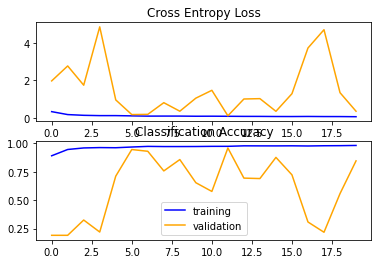

17/17 [==============================] - 5s 29ms/step


<ipython-input-23-7f533508ce45>:40: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead
  mean_tpr += interp(all_fpr, fpr[i], tpr[i])


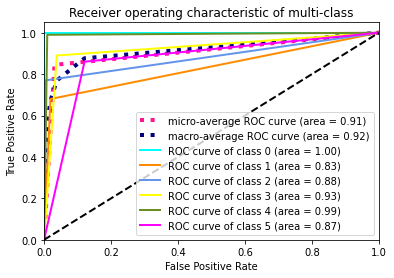

17/17 [==============================] - 1s 30ms/step
[[22  0  0  0  0  0]
 [ 0 68  1  0  0 31]
 [ 0  0 77 11  1 11]
 [ 0  0  1 89  2  8]
 [ 0  0  0  0 99  1]
 [ 0  8  0  5  1 86]]
validation_accuracy: 0.845


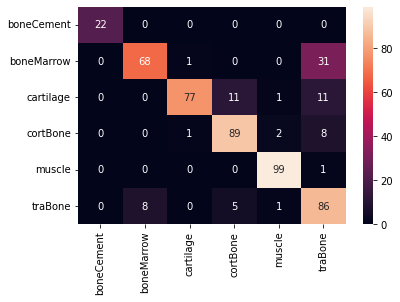

Sensitivity validation set: [1.   0.68 0.77 0.89 0.99 0.86]
Specificity validation set: [1.         0.98104265 0.99526066 0.96208531 0.99052133 0.87914692]
F1 validation set: [1.         0.77272727 0.8603352  0.86829268 0.97536946 0.7257384 ]
Average sensitivity validation set: 0.8650000000000001
Average specificity validation set: 0.9680094786729859
Average F1 validation set: 0.8670771676562299


In [ ]:
summarize_diagnostics(Dense_initial)
#ROC + AUC for validation set based on model 1:
lw = 2
#Get true classes
true_classes = np.array(y_test)
#Get predicted classes
predict_x = dense_net_model.predict(X_test)
predicted_classes_x = []
for l in predict_x:
  multi_array = np.zeros(6)
  x = l.argmax()
  multi_array[x] = 1
  predicted_classes_x.append(multi_array)

predicted_classes_x = np.array(predicted_classes_x)

class_names = np.unique(y)

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()
n_classes = 6
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(true_classes[:, i], predicted_classes_x[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Compute micro-average ROC curve and AUC
fpr["micro"], tpr["micro"], _ = roc_curve(true_classes.ravel(), predicted_classes_x.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

# Compute macro-average ROC curve and AUC

# First aggregate all false positive rates
all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = all_fpr
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

# Plot all ROC curves
plt.figure(1)
plt.plot(fpr["micro"], tpr["micro"],
         label='micro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["micro"]),
         color='deeppink', linestyle=':', linewidth=4)

plt.plot(fpr["macro"], tpr["macro"],
         label='macro-average ROC curve (area = {0:0.2f})'
               ''.format(roc_auc["macro"]),
         color='navy', linestyle=':', linewidth=4)

colors = cycle(['aqua', 'darkorange', 'cornflowerblue', 'yellow', 'olivedrab', 'magenta'])
for i, color in zip(range(n_classes), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=lw,
             label='ROC curve of class {0} (area = {1:0.2f})'
             ''.format(i, roc_auc[i]))

plt.plot([0, 1], [0, 1], 'k--', lw=lw)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver operating characteristic of multi-class')
plt.legend(loc="lower right")
plt.show("lower right")

#Test Accuracy and Confusion Matrix:
#Predict for v
y_pred = dense_net_model.predict(X_test)
confusion_matrix = sklearn.metrics.confusion_matrix(y_test.argmax(axis=1), np.rint(y_pred.argmax(axis=1)))
print(confusion_matrix)
acc = accuracy_score((y_test.argmax(axis=1)), y_pred.argmax(axis=1))
print('validation_accuracy: %.3f' % (acc))

DetaFrame_cm = pd.DataFrame(confusion_matrix, range(6), range(6))
snNew.heatmap(DetaFrame_cm, annot=True, yticklabels=['boneCement', 'boneMarrow', 'cartilage', 'cortBone', 'muscle',
       'traBone'], xticklabels=['boneCement', 'boneMarrow', 'cartilage', 'cortBone', 'muscle',
       'traBone'])
plt.show()

#Specificity and Sensitivity for each class:
FP = confusion_matrix.sum(axis=0) - np.diag(confusion_matrix) 
FN = confusion_matrix.sum(axis=1) - np.diag(confusion_matrix)
TP = np.diag(confusion_matrix)
TN = confusion_matrix.sum() - (FP + FN + TP)
FP = FP.astype(float)
FN = FN.astype(float)
TP = TP.astype(float)
TN = TN.astype(float)
# Sensitivity, hit rate, recall, or true positive rate
TPR = TP/(TP+FN)
#Average sensitivity
avTPR = sum(TPR) / len(TPR)
# Specificity or true negative rate
TNR = TN/(TN+FP)
#Average Specificity
avTNR = sum(TNR) / len(TNR)
#Precision
P = TP / (TP + FP)
#F1 score
F1 = 2*(P*TPR / (P + TPR))
#Average F1
avF1 = sum(F1) / len(F1)
print('Sensitivity validation set:', TPR)
print('Specificity validation set:', TNR)
print('F1 validation set:', F1)
print('Average sensitivity validation set:', avTPR)
print('Average specificity validation set:', avTNR)
print('Average F1 validation set:', avF1)